# Image Classification

Importing modules

In [1]:
import numpy as np
import pandas as pd
import os
# checking the files
for dirname, _, filenames in os.walk("./ImageDataset"):
    for filename in filenames:
        print(os.path.join(dirname, filename))
        break

./ImageDataset\archive (1).zip
./ImageDataset\crop_images\jute\jute001a.jpeg
./ImageDataset\crop_images\maize\maize001a.jpeg
./ImageDataset\crop_images\rice\rice001a.jpeg
./ImageDataset\crop_images\sugarcane\sugarcane0001a.jpeg
./ImageDataset\crop_images\wheat\wheat0001a.jpeg
./ImageDataset\kag2\jute\jute001a.jpeg
./ImageDataset\kag2\maize\maize001a.jpeg
./ImageDataset\kag2\rice\rice001a.jpeg
./ImageDataset\kag2\sugarcane\sugarcane0001a.jpeg
./ImageDataset\kag2\wheat\wheat0001a.jpeg
./ImageDataset\some_more_images\some_more_images\jute\jute041a.jpg
./ImageDataset\some_more_images\some_more_images\maize\maize041a.jpg
./ImageDataset\some_more_images\some_more_images\rice\rice041a.jpg
./ImageDataset\some_more_images\some_more_images\sugarcane\sugarcane041a.jpg
./ImageDataset\some_more_images\some_more_images\Wheat\wheat041a.jpg
./ImageDataset\test_crop_image\jute-field.jpg


In [2]:
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import keras
from keras.layers import Conv2D
from keras.models import Sequential
from keras.layers import MaxPool2D
from keras.layers import Flatten
from keras.layers import Dense
from keras.models import Model
from keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
import cv2
import re
import random
random.seed(0)
np.random.seed(0)

Plotting images for reference

Text(0.5, 1.0, 'wheat')

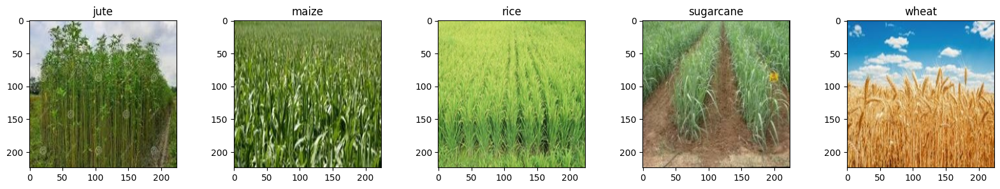

In [5]:
wheat = plt.imread("./ImageDataset/kag2/wheat/wheat0004a.jpeg")
jute = plt.imread("./ImageDataset/kag2/jute/jute005a.jpeg")
cane = plt.imread("./ImageDataset/kag2/sugarcane/sugarcane0010arot.jpeg")
rice = plt.imread("./ImageDataset/kag2/rice/rice032ahs.jpeg")
maize = plt.imread("./ImageDataset/kag2/maize/maize003a.jpeg")
plt.figure(figsize=(20,3))
plt.subplot(1,5,1)
plt.imshow(jute)
plt.title("jute")
plt.subplot(1,5,2)
plt.imshow(maize)
plt.title("maize")
plt.subplot(1,5,3)
plt.imshow(rice)
plt.title("rice")
plt.subplot(1,5,4)
plt.imshow(cane)
plt.title("sugarcane")
plt.subplot(1,5,5)
plt.imshow(wheat)
plt.title("wheat")

In [6]:
jutepath = "./ImageDataset/kag2/jute"
maizepath = "./ImageDataset/kag2/maize"
ricepath = "./ImageDataset/kag2/rice"
sugarcanepath = "./ImageDataset/kag2/sugarcane"
wheatpath = "./ImageDataset/kag2/wheat"

jutefilename = os.listdir(jutepath)
maizefilename = os.listdir(maizepath)
ricefilename = os.listdir(ricepath)
sugarcanefilename = os.listdir(sugarcanepath)
wheatfilename = os.listdir(wheatpath)

X= []

In [7]:
for fname in jutefilename:
    X.append([os.path.join(jutepath,fname),0])
for fname in maizefilename:
    X.append([os.path.join(maizepath,fname),1])
for fname in ricefilename:
    X.append([os.path.join(ricepath,fname),2])
for fname in sugarcanefilename:
    X.append([os.path.join(sugarcanepath,fname),3])
for fname in wheatfilename:
    X.append([os.path.join(wheatpath,fname),4])
X = pd.DataFrame(X,columns = ['path','labels'])

In [8]:
X.head()

,path,labels
0,./ImageDataset/kag2/jute\jute001a.jpeg,0
1,./ImageDataset/kag2/jute\jute001ahf.jpeg,0
2,./ImageDataset/kag2/jute\jute001ahs.jpeg,0
3,./ImageDataset/kag2/jute\jute001arot.jpeg,0
4,./ImageDataset/kag2/jute\jute002a.jpeg,0


In [9]:
ohencoder = OneHotEncoder(handle_unknown='ignore',sparse=False)
ohlabel = pd.DataFrame(ohencoder.fit_transform(X[['labels']]),dtype = 'float64',columns = ['label0','label1','label2','label3','label4'])
label_X = X.copy()
X = pd.concat([X,ohlabel],axis = 1)
new_X = X.drop(['labels'],axis = 1)

In [10]:
train,test = train_test_split(new_X,test_size=0.2,random_state=32,shuffle = True)

In [11]:
X_train = train['path'].values
y_train = train.drop(['path'],axis=1).values
X_test = test['path'].values
y_test = test.drop(['path'],axis=1).values

In [3]:
def deep_pipeline(data):
    flat = []
    for i in data:
        img = plt.imread(i)
        img = img/255.
        flat.append(img)
    flat =  np.array(flat)
    flat = flat.reshape(-1,224,224,3)
    return flat

In [13]:
dx_train = deep_pipeline(X_train)
dx_test = deep_pipeline(X_test)

Model Training

In [14]:
keras.backend.clear_session()
vgg = keras.applications.VGG19(input_shape=(224,224,3),include_top=False,weights = 'imagenet',pooling='avg')
vgg.trainable = False
vggmodel = keras.Sequential([vgg, Dense(1000,activation='tanh'),Dense(1000,activation='tanh'),Dense(1000,activation='tanh'),Dense(5,activation='softmax')])

vggmodel.compile(optimizer = 'adam',loss = 'categorical_crossentropy',metrics=['accuracy'])
vggmodel.summary()

80134624/80134624 [==============================] - 83s 1us/step
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg19 (Functional)          (None, 512)               20024384  
                                                                 
 dense (Dense)               (None, 1000)              513000    
                                                                 
 dense_1 (Dense)             (None, 1000)              1001000   
                                                                 
 dense_2 (Dense)             (None, 1000)              1001000   
                                                                 
 dense_3 (Dense)             (None, 5)                 5005      
                                                                 
Total params: 22,544,389
Trainable params: 2,520,005
Non-trainable params: 20,024,384
____________________________________

In [15]:
hist = vggmodel.fit(dx_train,y_train,epochs=50,validation_split=0.3,batch_size=16)

Epoch 1/50
29/29 [==============================] - 249s 9s/step - loss: 3.2240 - accuracy: 0.2489 - val_loss: 1.7898 - val_accuracy: 0.3886
Epoch 2/50
29/29 [==============================] - 271s 9s/step - loss: 1.4731 - accuracy: 0.3889 - val_loss: 1.1803 - val_accuracy: 0.4870
Epoch 3/50
29/29 [==============================] - 273s 10s/step - loss: 1.1451 - accuracy: 0.5178 - val_loss: 0.8455 - val_accuracy: 0.6684
Epoch 4/50
29/29 [==============================] - 272s 9s/step - loss: 0.9702 - accuracy: 0.6044 - val_loss: 1.7210 - val_accuracy: 0.3990
Epoch 5/50
29/29 [==============================] - 275s 10s/step - loss: 0.8658 - accuracy: 0.6578 - val_loss: 0.8465 - val_accuracy: 0.6477
Epoch 6/50
29/29 [==============================] - 274s 10s/step - loss: 0.6820 - accuracy: 0.7311 - val_loss: 0.6400 - val_accuracy: 0.7668
Epoch 7/50
29/29 [==============================] - 274s 10s/step - loss: 0.5821 - accuracy: 0.7978 - val_loss: 0.9678 - val_accuracy: 0.6166
Epoch 8/5

(0.0, 4.0)

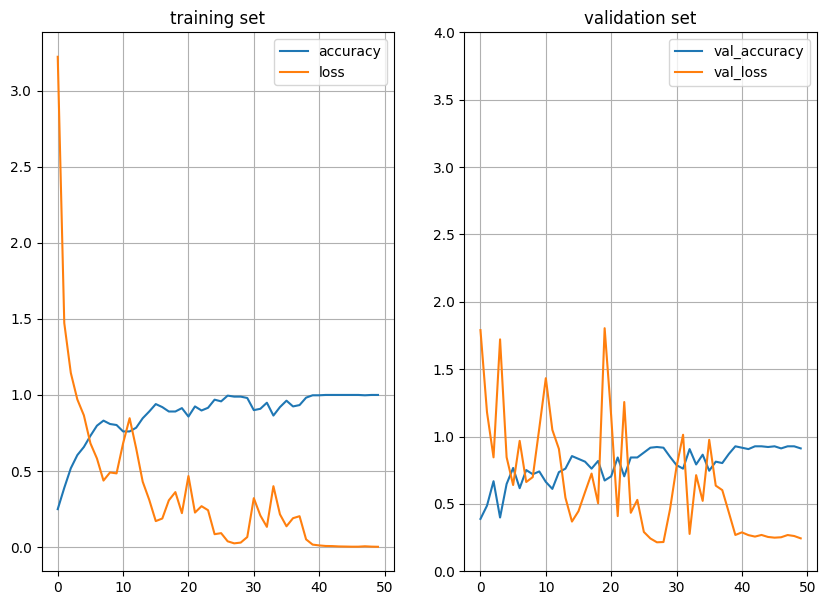

In [16]:
plt.figure(figsize=(10,7))
plt.subplot(1,2,1)
plt.plot(hist.history['accuracy'],label='accuracy')
plt.plot(hist.history['loss'],label='loss')
plt.legend()
plt.title("training set")
plt.grid()
plt.subplot(1,2,2)
plt.plot(hist.history['val_accuracy'],label='val_accuracy')
plt.plot(hist.history['val_loss'],label='val_loss')
plt.legend()
plt.title("validation set")
plt.grid()
plt.ylim((0,4))

Testing Accuracy

In [18]:
score = vggmodel.evaluate(dx_test,y_test)
print("accuracy: ", score[1])

6/6 [==============================] - 60s 10s/step - loss: 0.1795 - accuracy: 0.9627
accuracy:  0.9627329111099243


In [23]:
pred = vggmodel.predict(dx_test)
prediction = np.argmax(pred,axis=1)
true = np.argmax(y_test,axis=1)
best_prob = [pred[num,:][i] for num,i in enumerate(prediction)]

6/6 [==============================] - 59s 10s/step


Pipelining

In [25]:
def deepmodelpipeline(imagepath,model = vggmodel,label=[-1]):
    Predicted_crop=""
    pdict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    pred_x = deep_pipeline([imagepath])
    prediction = model.predict(pred_x)
    pred = np.argmax(prediction[0])
    plt.imshow(plt.imread(imagepath))
    if (label[0]!=-1):
        plt.title("prediction : {0} % {1:.2f} \ntrue        : {2}".format(pdict[pred],prediction[0,pred]*100,pdict[np.argmax(label)]))
        Predicted_crop=pdict[pred]
    else:
        plt.title("prediction : {0}, % {1:.2f}".format(pdict[pred],prediction[0,pred]*100))
        Predicted_crop=pdict[pred]
    return Predicted_crop

1/1 [==============================] - 0s 447ms/step
rice


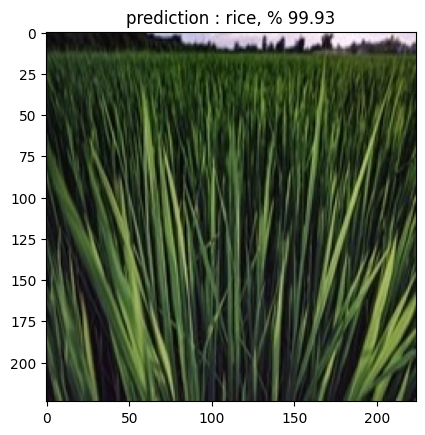

In [26]:
Pred1=deepmodelpipeline('./ImageDataset/kag2/rice/rice024ahs.jpeg')
print(Pred1)

1/1 [==============================] - 0s 458ms/step
wheat


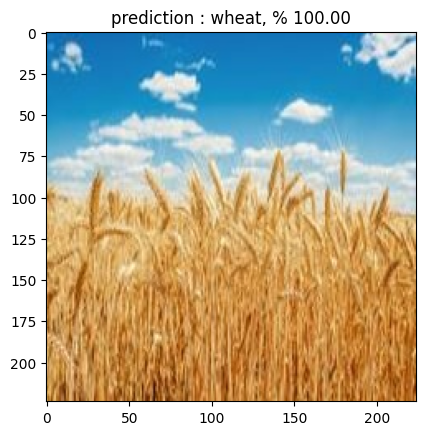

In [27]:
Pred1=deepmodelpipeline('./ImageDataset/kag2/wheat/wheat0004a.jpeg')
print(Pred1)

1/1 [==============================] - 0s 426ms/step
wheat


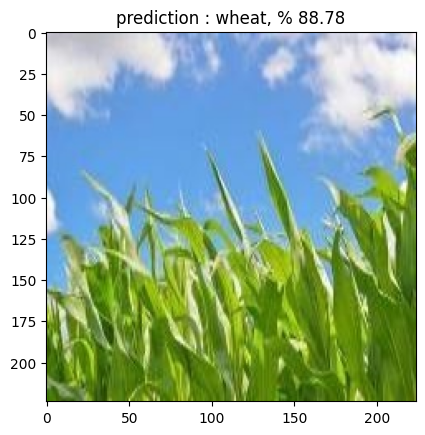

In [28]:
Pred1=deepmodelpipeline("./ImageDataset/kag2/maize/maize008ahf.jpeg")
print(Pred1)

1/1 [==============================] - 0s 442ms/step
jute


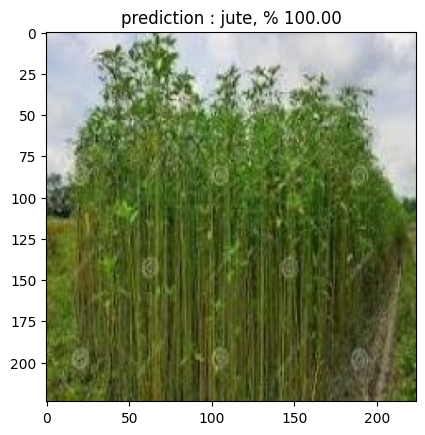

In [29]:
Pred1=deepmodelpipeline("./ImageDataset/kag2/jute/jute005a.jpeg")
print(Pred1)

Prediction over a set of images

1/1 [==============================] - 0s 415ms/step
wheat
1/1 [==============================] - 0s 455ms/step
rice
1/1 [==============================] - 0s 446ms/step
wheat
1/1 [==============================] - 0s 415ms/step
sugarcane
1/1 [==============================] - 0s 454ms/step
sugarcane
1/1 [==============================] - 0s 435ms/step
wheat
1/1 [==============================] - 0s 424ms/step
maize
1/1 [==============================] - 0s 426ms/step
wheat
1/1 [==============================] - 0s 418ms/step
wheat
1/1 [==============================] - 0s 464ms/step
jute
1/1 [==============================] - 0s 442ms/step
rice
1/1 [==============================] - 1s 519ms/step
maize
1/1 [==============================] - 1s 510ms/step
wheat
1/1 [==============================] - 0s 424ms/step
jute
1/1 [==============================] - 0s 470ms/step
maize
1/1 [==============================] - 0s 440ms/step
wheat
1/1 [==============================] - 0s 461ms/step

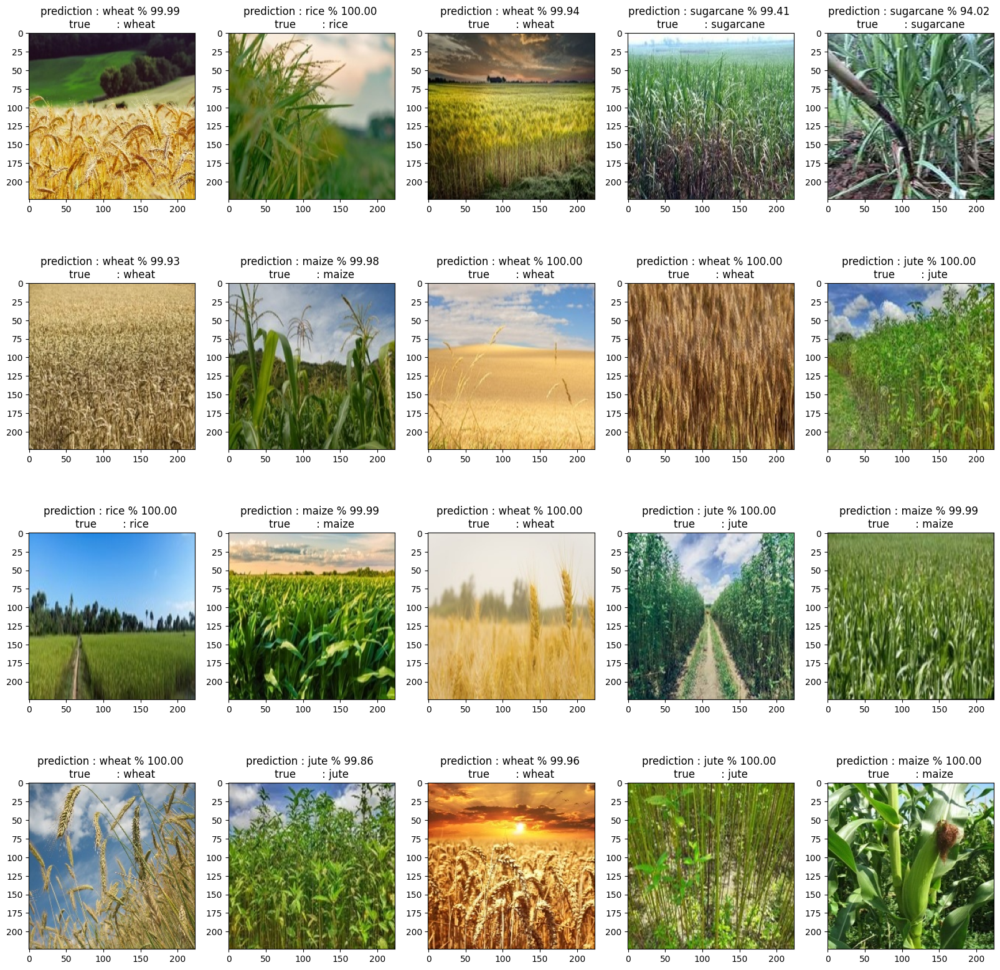

In [30]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[0:20]):
    plt.subplot(4,5,num+1)
    Pred1=deepmodelpipeline(path,vggmodel,y_test[num])
    print(Pred1)

1/1 [==============================] - 0s 399ms/step
jute
1/1 [==============================] - 0s 429ms/step
maize
1/1 [==============================] - 0s 422ms/step
jute
1/1 [==============================] - 0s 459ms/step
rice
1/1 [==============================] - 0s 424ms/step
wheat
1/1 [==============================] - 0s 423ms/step
wheat
1/1 [==============================] - 0s 434ms/step
maize
1/1 [==============================] - 0s 406ms/step
rice
1/1 [==============================] - 0s 419ms/step
maize
1/1 [==============================] - 0s 414ms/step
maize
1/1 [==============================] - 0s 441ms/step
wheat
1/1 [==============================] - 0s 461ms/step
wheat
1/1 [==============================] - 0s 417ms/step
sugarcane
1/1 [==============================] - 0s 442ms/step
rice
1/1 [==============================] - 0s 397ms/step
sugarcane
1/1 [==============================] - 0s 423ms/step
jute
1/1 [==============================] - 0s 412ms/step
j

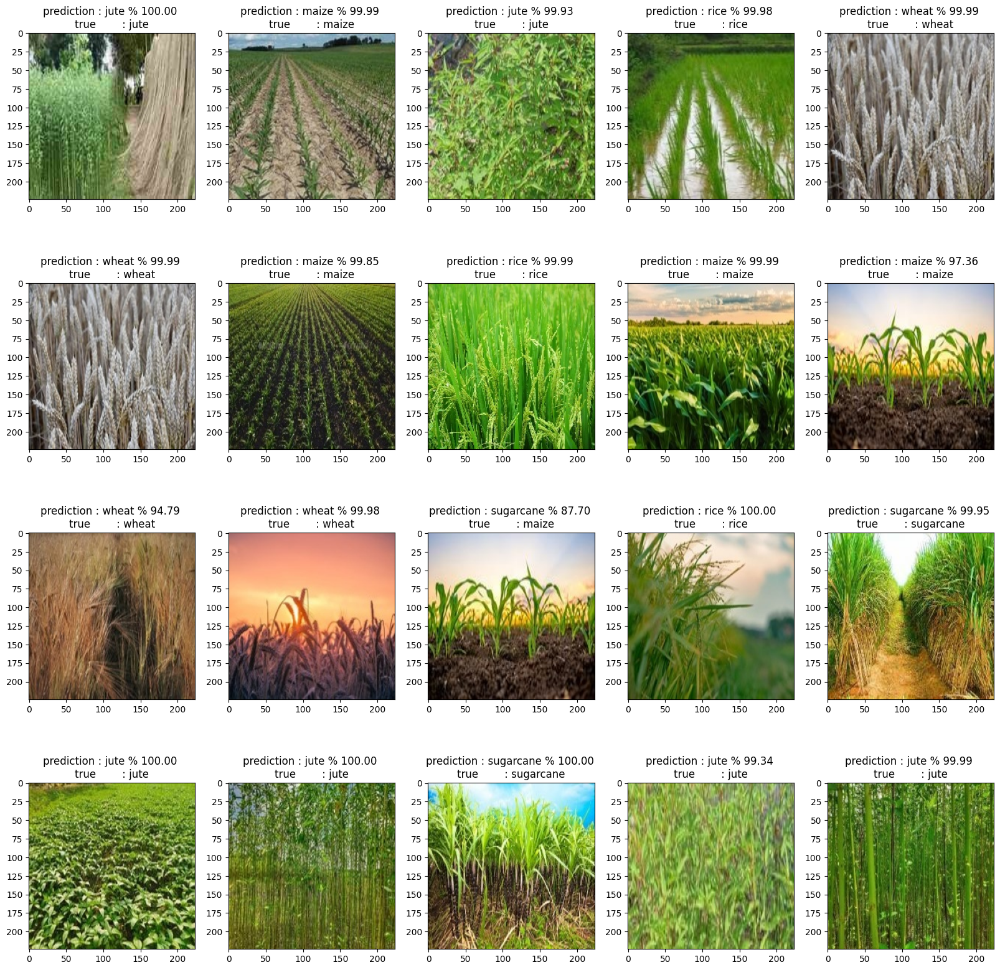

In [31]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[20:40]):
    plt.subplot(4,5,num+1)
    Pred1=deepmodelpipeline(path,vggmodel,y_test[num+20])
    print(Pred1)

1/1 [==============================] - 0s 428ms/step
rice
1/1 [==============================] - 1s 515ms/step
maize
1/1 [==============================] - 0s 468ms/step
wheat
1/1 [==============================] - 0s 476ms/step
rice
1/1 [==============================] - 0s 444ms/step
rice
1/1 [==============================] - 0s 467ms/step
maize
1/1 [==============================] - 0s 398ms/step
sugarcane
1/1 [==============================] - 0s 465ms/step
maize
1/1 [==============================] - 0s 432ms/step
wheat
1/1 [==============================] - 0s 421ms/step
rice
1/1 [==============================] - 0s 422ms/step
maize
1/1 [==============================] - 0s 431ms/step
maize
1/1 [==============================] - 0s 481ms/step
jute
1/1 [==============================] - 0s 452ms/step
maize
1/1 [==============================] - 0s 459ms/step
wheat
1/1 [==============================] - 0s 436ms/step
wheat
1/1 [==============================] - 1s 503ms/step
suga

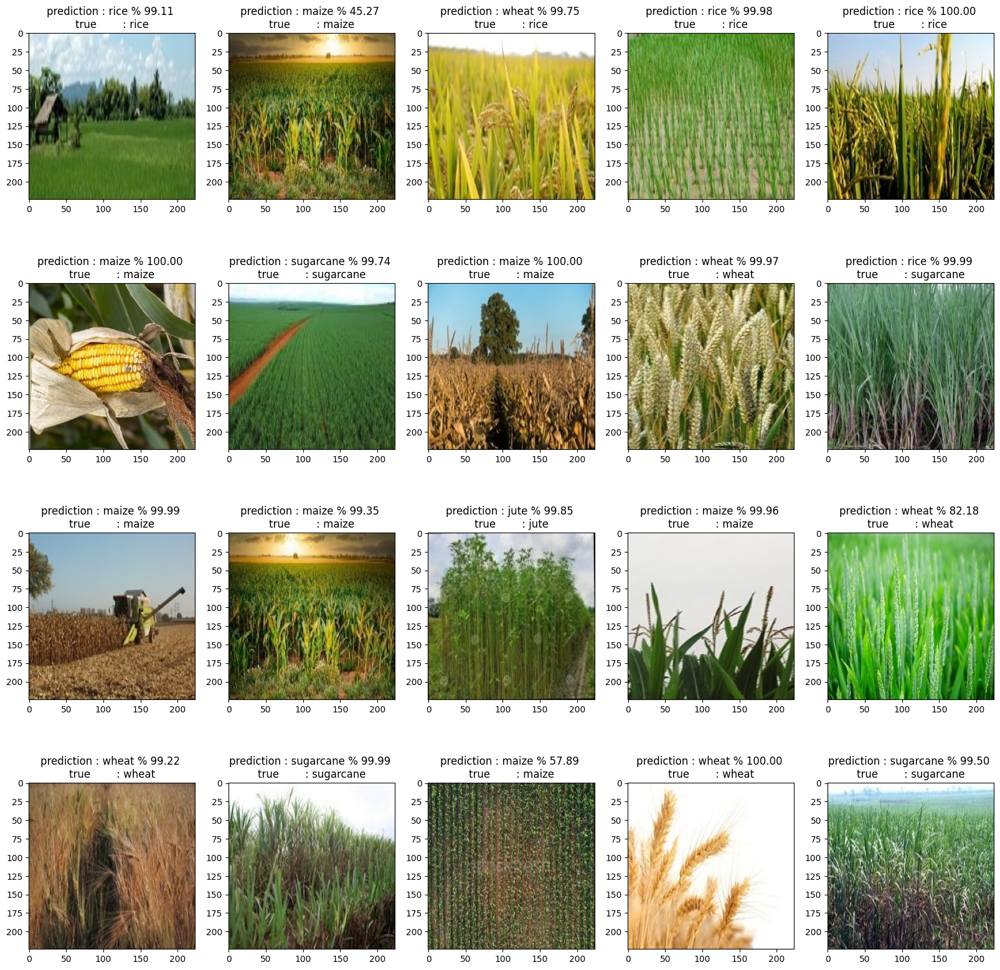

In [32]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[40:60]):
    plt.subplot(4,5,num+1)
    Pred1=deepmodelpipeline(path,vggmodel,y_test[num+40])
    print(Pred1)

1/1 [==============================] - 1s 510ms/step
jute
1/1 [==============================] - 0s 447ms/step
jute
1/1 [==============================] - 0s 420ms/step
wheat
1/1 [==============================] - 0s 429ms/step
maize
1/1 [==============================] - 0s 422ms/step
rice
1/1 [==============================] - 1s 513ms/step
jute
1/1 [==============================] - 0s 416ms/step
rice
1/1 [==============================] - 0s 443ms/step
wheat
1/1 [==============================] - 0s 440ms/step
sugarcane
1/1 [==============================] - 0s 461ms/step
wheat
1/1 [==============================] - 1s 522ms/step
sugarcane
1/1 [==============================] - 0s 449ms/step
wheat
1/1 [==============================] - 0s 475ms/step
rice
1/1 [==============================] - 0s 438ms/step
sugarcane
1/1 [==============================] - 0s 466ms/step
wheat
1/1 [==============================] - 0s 453ms/step
maize
1/1 [==============================] - 1s 611ms/st

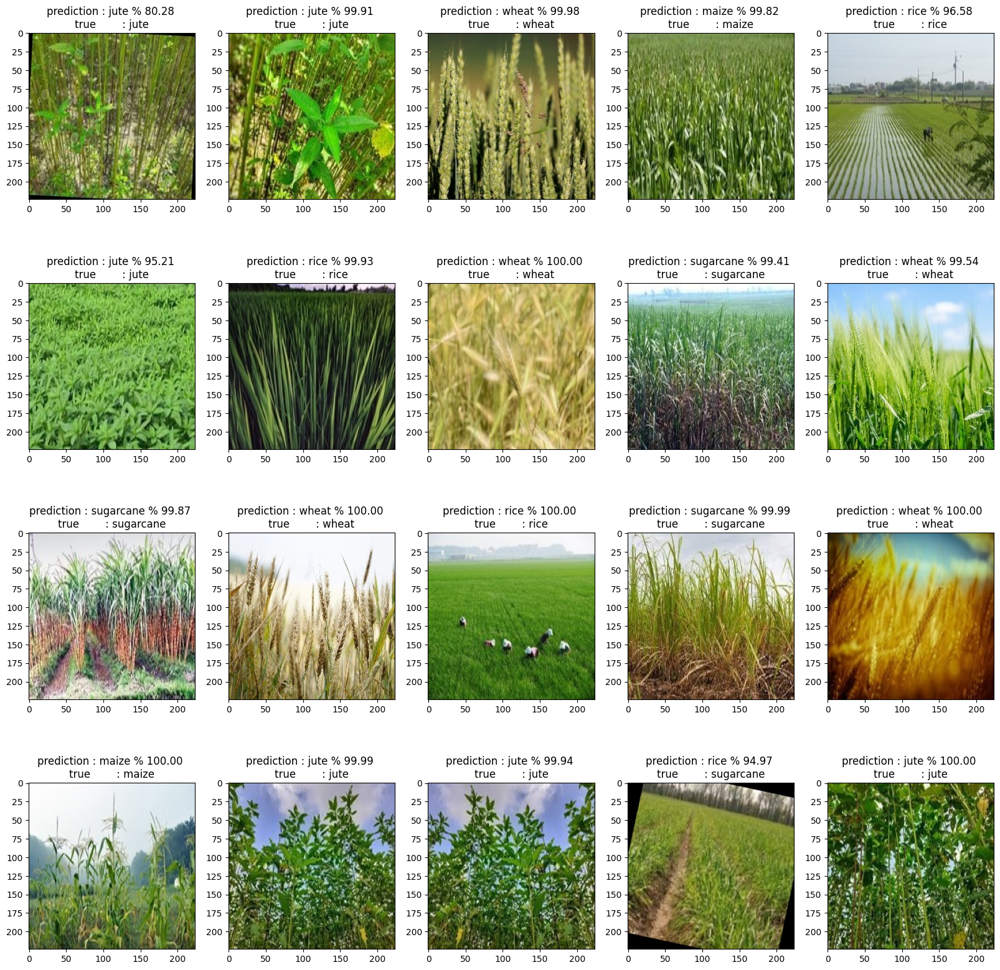

In [33]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[100:120]):
    plt.subplot(4,5,num+1)
    Pred1=deepmodelpipeline(path,vggmodel,y_test[num+100])
    print(Pred1)

1/1 [==============================] - 0s 486ms/step
rice
1/1 [==============================] - 0s 448ms/step
maize
1/1 [==============================] - 0s 402ms/step
jute
1/1 [==============================] - 1s 528ms/step
maize
1/1 [==============================] - 0s 448ms/step
rice
1/1 [==============================] - 0s 449ms/step
rice
1/1 [==============================] - 0s 451ms/step
sugarcane
1/1 [==============================] - 0s 434ms/step
sugarcane
1/1 [==============================] - 0s 443ms/step
jute
1/1 [==============================] - 0s 429ms/step
sugarcane
1/1 [==============================] - 0s 422ms/step
rice
1/1 [==============================] - 0s 419ms/step
sugarcane
1/1 [==============================] - 0s 417ms/step
rice
1/1 [==============================] - 0s 418ms/step
jute
1/1 [==============================] - 0s 439ms/step
jute
1/1 [==============================] - 0s 431ms/step
wheat
1/1 [==============================] - 0s 430ms/s

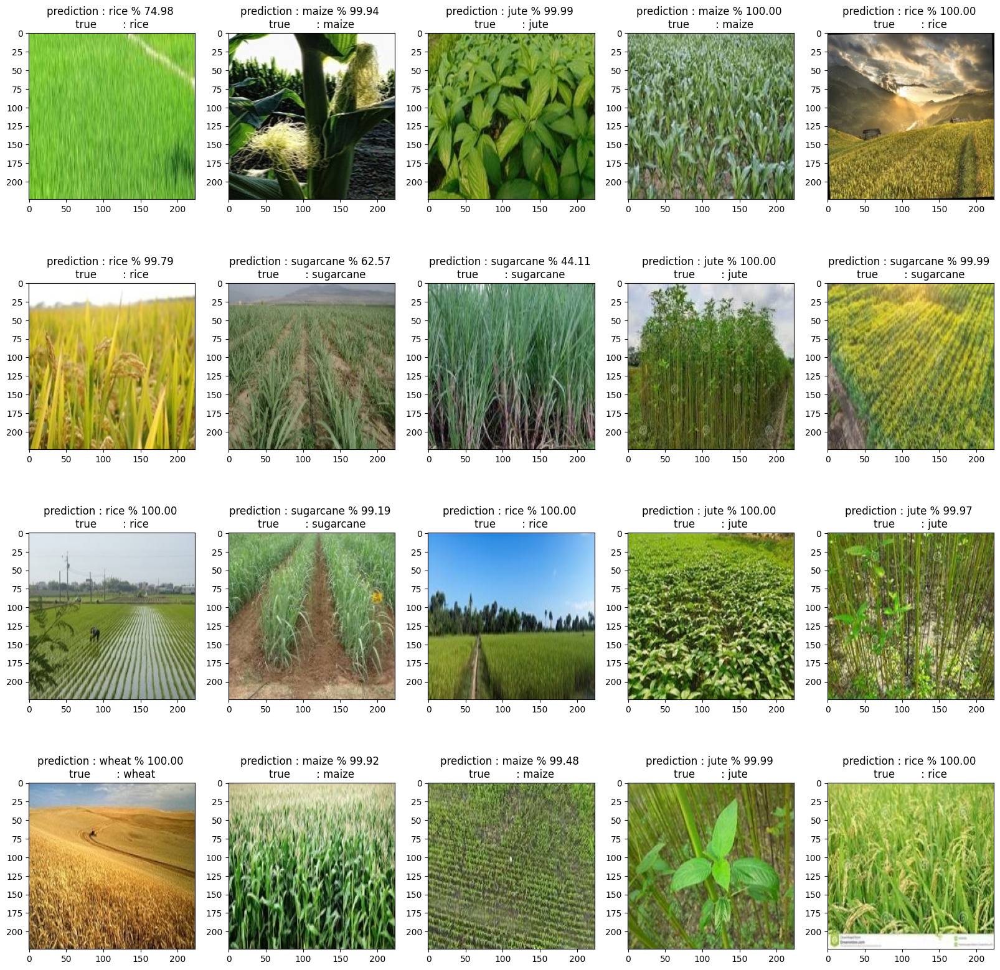

In [34]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[140:160]):
    plt.subplot(4,5,num+1)
    pred1=deepmodelpipeline(path,vggmodel,y_test[num+140])
    print(pred1)

Saving Model

In [43]:
vggmodel.save('vgg19_model.h5')

In [44]:
from tensorflow.keras.models import load_model

In [45]:
load_model=load_model('vgg19_model.h5')

1/1 [==============================] - 1s 855ms/step
rice
1/1 [==============================] - 0s 434ms/step
maize
1/1 [==============================] - 0s 477ms/step
jute
1/1 [==============================] - 0s 485ms/step
maize
1/1 [==============================] - 0s 496ms/step
rice
1/1 [==============================] - 0s 454ms/step
rice
1/1 [==============================] - 0s 477ms/step
sugarcane
1/1 [==============================] - 1s 501ms/step
sugarcane
1/1 [==============================] - 0s 464ms/step
jute
1/1 [==============================] - 0s 465ms/step
sugarcane
1/1 [==============================] - 0s 476ms/step
rice
1/1 [==============================] - 0s 486ms/step
sugarcane
1/1 [==============================] - 0s 487ms/step
rice
1/1 [==============================] - 0s 451ms/step
jute
1/1 [==============================] - 0s 443ms/step
jute
1/1 [==============================] - 0s 427ms/step
wheat
1/1 [==============================] - 0s 431ms/s

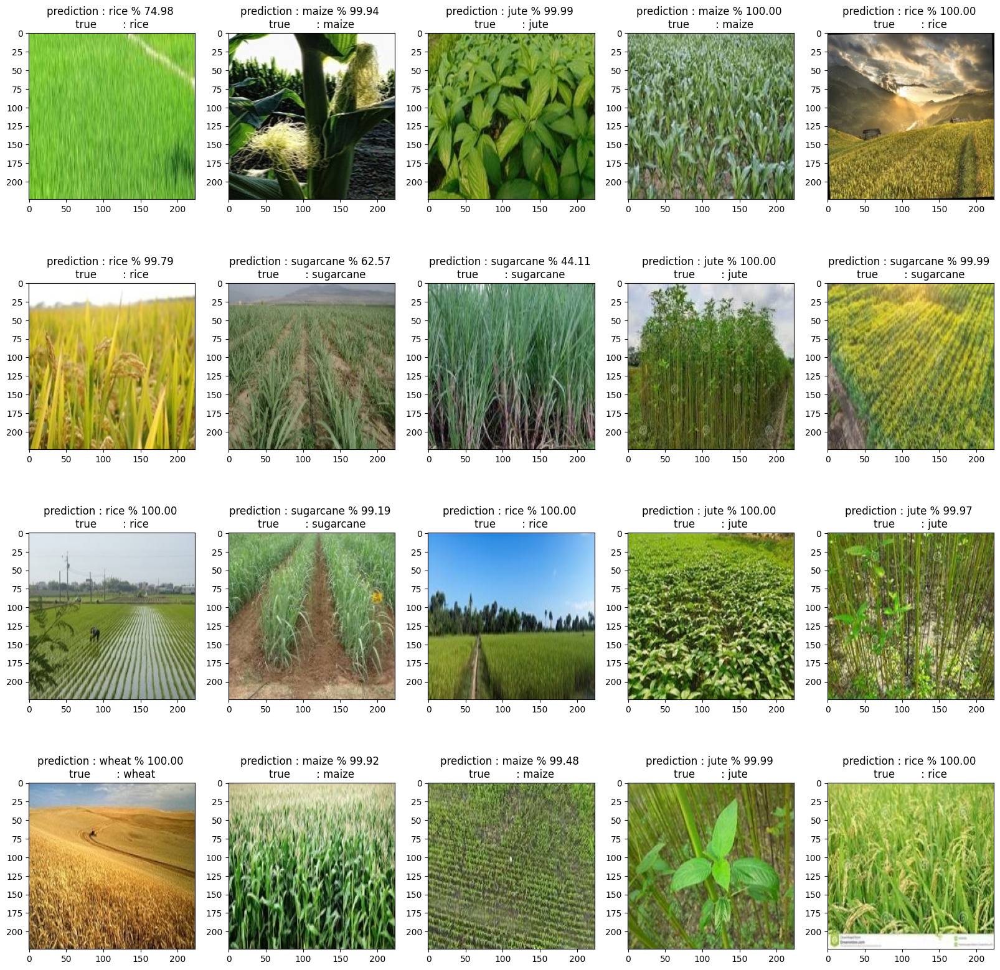

In [47]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[140:160]):
    plt.subplot(4,5,num+1)
    pred1=deepmodelpipeline(path,load_model,y_test[num+140])
    print(pred1)

In [79]:
def deepmodelpipelineload_model(imagepath,model = load_model,label=[-1]):
    Predicted_crop=""
    pdict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    pred_x = deep_pipeline([imagepath])
    prediction = model.predict(pred_x)
    pred = np.argmax(prediction[0])
    plt.imshow(plt.imread(imagepath))
    if (label[0]!=-1):
        plt.title("prediction : {0} % {1:.2f} \ntrue        : {2}".format(pdict[pred],prediction[0,pred]*100,pdict[np.argmax(label)]))
        Predicted_crop=pdict[pred]
    else:
        plt.title("prediction : {0}, % {1:.2f}".format(pdict[pred],prediction[0,pred]*100))
        Predicted_crop=pdict[pred]
    return Predicted_crop

In [5]:
from keras.models import load_model

In [6]:
vgg19_model = load_model("vgg19_model.h5")

In [7]:
def deepmodelpipeline(imagepath,model = vgg19_model,label=[-1]):
    Predicted_crop=""
    pdict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    pred_x = deep_pipeline([imagepath])
    prediction = model.predict(pred_x)
    pred = np.argmax(prediction[0])
    plt.imshow(plt.imread(imagepath))
    if (label[0]!=-1):
        plt.title("prediction : {0} % {1:.2f} \ntrue        : {2}".format(pdict[pred],prediction[0,pred]*100,pdict[np.argmax(label)]))
        Predicted_crop=pdict[pred]
    else:
        plt.title("prediction : {0}, % {1:.2f}".format(pdict[pred],prediction[0,pred]*100))
        Predicted_crop=pdict[pred]
    return Predicted_crop

# Crop Yeild Prediction

In [48]:
import matplotlib.pyplot as plt
import seaborn as sns

In [49]:
df = pd.read_csv("./crop_production.csv")
df[:5]

,State_Name,District_Name,Crop_Year,Season,Crop,Area,Production
0,Andaman and Nicobar Islands,NICOBARS,2000,Kharif,Arecanut,1254.0,2000.0
1,Andaman and Nicobar Islands,NICOBARS,2000,Kharif,Other Kharif pulses,2.0,1.0
2,Andaman and Nicobar Islands,NICOBARS,2000,Kharif,Rice,102.0,321.0
3,Andaman and Nicobar Islands,NICOBARS,2000,Whole Year,Banana,176.0,641.0
4,Andaman and Nicobar Islands,NICOBARS,2000,Whole Year,Cashewnut,720.0,165.0


In [50]:
df.isnull().sum()

State_Name          0
District_Name       0
Crop_Year           0
Season              0
Crop                0
Area                0
Production       3730
dtype: int64

In [51]:
# Droping Nan Values
data = df.dropna()
print(data.shape)
test = df[~df["Production"].notna()].drop("Production",axis=1)
print(test.shape)

(242361, 7)
(3730, 6)


In [52]:
for i in data.columns:
    print("column name :",i)
    print("No. of column :",len(data[i].unique()))
    print(data[i].unique())

column name : State_Name
No. of column : 33
['Andaman and Nicobar Islands' 'Andhra Pradesh' 'Arunachal Pradesh'
 'Assam' 'Bihar' 'Chandigarh' 'Chhattisgarh' 'Dadra and Nagar Haveli'
 'Goa' 'Gujarat' 'Haryana' 'Himachal Pradesh' 'Jammu and Kashmir '
 'Jharkhand' 'Karnataka' 'Kerala' 'Madhya Pradesh' 'Maharashtra' 'Manipur'
 'Meghalaya' 'Mizoram' 'Nagaland' 'Odisha' 'Puducherry' 'Punjab'
 'Rajasthan' 'Sikkim' 'Tamil Nadu' 'Telangana ' 'Tripura' 'Uttar Pradesh'
 'Uttarakhand' 'West Bengal']
column name : District_Name
No. of column : 646
['NICOBARS' 'NORTH AND MIDDLE ANDAMAN' 'SOUTH ANDAMANS' 'ANANTAPUR'
 'CHITTOOR' 'EAST GODAVARI' 'GUNTUR' 'KADAPA' 'KRISHNA' 'KURNOOL'
 'PRAKASAM' 'SPSR NELLORE' 'SRIKAKULAM' 'VISAKHAPATANAM' 'VIZIANAGARAM'
 'WEST GODAVARI' 'ANJAW' 'CHANGLANG' 'DIBANG VALLEY' 'EAST KAMENG'
 'EAST SIANG' 'KURUNG KUMEY' 'LOHIT' 'LONGDING' 'LOWER DIBANG VALLEY'
 'LOWER SUBANSIRI' 'NAMSAI' 'PAPUM PARE' 'TAWANG' 'TIRAP' 'UPPER SIANG'
 'UPPER SUBANSIRI' 'WEST KAMENG' 'WEST SIANG

In [53]:
sum_maxp = data["Production"].sum()
data["percent_of_production"] = data["Production"].map(lambda x:(x/sum_maxp)*100)

In [54]:
data[:5]

,State_Name,District_Name,Crop_Year,Season,Crop,Area,Production,percent_of_production
0,Andaman and Nicobar Islands,NICOBARS,2000,Kharif,Arecanut,1254.0,2000.0,1.416670e-06
1,Andaman and Nicobar Islands,NICOBARS,2000,Kharif,Other Kharif pulses,2.0,1.0,7.083351e-10
2,Andaman and Nicobar Islands,NICOBARS,2000,Kharif,Rice,102.0,321.0,2.273756e-07
3,Andaman and Nicobar Islands,NICOBARS,2000,Whole Year,Banana,176.0,641.0,4.540428e-07
4,Andaman and Nicobar Islands,NICOBARS,2000,Whole Year,Cashewnut,720.0,165.0,1.168753e-07


In [55]:
data.groupby("Season",axis=0).agg({"Production":np.sum})

,Production
Season,
Autumn,6.441377e+07
Kharif,4.029970e+09
Rabi,2.051688e+09
Summer,1.706579e+08
Whole Year,1.344248e+11
Winter,4.345498e+08


In [56]:
data["Crop"].value_counts()[:5]

Crop
Rice                 15082
Maize                13787
Moong(Green Gram)    10106
Urad                  9710
Sesamum               8821
Name: count, dtype: int64

In [57]:
top_crop_pro = data.groupby("Crop")["Production"].sum().reset_index().sort_values(by='Production',ascending=False)
top_crop_pro[:5]

,Crop,Production
28,Coconut,1.299816e+11
106,Sugarcane,5.535682e+09
95,Rice,1.605470e+09
119,Wheat,1.332826e+09
87,Potato,4.248263e+08


Feature Selection

In [58]:
data1 = data.drop(["District_Name","Crop_Year"],axis=1)

In [59]:
data_dum = pd.get_dummies(data1)
data_dum[:5]

,Area,Production,percent_of_production,State_Name_Andaman and Nicobar Islands,State_Name_Andhra Pradesh,State_Name_Arunachal Pradesh,State_Name_Assam,State_Name_Bihar,State_Name_Chandigarh,State_Name_Chhattisgarh,...,Crop_Turmeric,Crop_Turnip,Crop_Urad,Crop_Varagu,Crop_Water Melon,Crop_Wheat,Crop_Yam,Crop_other fibres,Crop_other misc. pulses,Crop_other oilseeds
0,1254.0,2000.0,1.416670e-06,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,2.0,1.0,7.083351e-10,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,102.0,321.0,2.273756e-07,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,176.0,641.0,4.540428e-07,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,720.0,165.0,1.168753e-07,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


Test Train Split

In [60]:
x = data_dum.drop("Production",axis=1)
y = data_dum[["Production"]]
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.33, random_state=42)
print("x_train :",x_train.shape)
print("x_test :",x_test.shape)
print("y_train :",y_train.shape)
print("y_test :",y_test.shape)

x_train : (162381, 165)
x_test : (79980, 165)
y_train : (162381, 1)
y_test : (79980, 1)


In [61]:
x_train[:5]

,Area,percent_of_production,State_Name_Andaman and Nicobar Islands,State_Name_Andhra Pradesh,State_Name_Arunachal Pradesh,State_Name_Assam,State_Name_Bihar,State_Name_Chandigarh,State_Name_Chhattisgarh,State_Name_Dadra and Nagar Haveli,...,Crop_Turmeric,Crop_Turnip,Crop_Urad,Crop_Varagu,Crop_Water Melon,Crop_Wheat,Crop_Yam,Crop_other fibres,Crop_other misc. pulses,Crop_other oilseeds
4843,785.0,1.486087e-06,False,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
20626,1250.0,5.829598e-07,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
240277,2.0,1.452087e-07,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
20664,60.0,4.646678e-07,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
157859,605.0,6.729184e-08,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


Model-1: Random Forest

In [62]:
from sklearn.ensemble import RandomForestRegressor
model = RandomForestRegressor()
model.fit(x_train,y_train)
preds = model.predict(x_test)

In [63]:
from sklearn.metrics import r2_score
r = r2_score(y_test,preds)
print("R2score when we predict using Randomn forest is ",r)

R2score when we predict using Randomn forest is  0.9975905401317777


Model-2: Linear Regression

In [64]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(x_train,y_train)

LinearRegression()

In [65]:
preds = model.predict(x_test)

In [66]:
from sklearn.metrics import mean_squared_error, r2_score
mean_squared_error(y_test,preds)
r2_score(y_test,preds)

1.0